
Introduction

Business Goal 
To assist a supermarket increase their membership card conversion rate, I will explore different clustering techniques and perform a customer segmentation analysis. Customer segmentation describes the process of identifying similar groups of customers based on commonalities like shopping preferences and purchasing history and allows companies to market to each group more effectively. In this notebook, I will develop several clustering models to gain a better understanding of the types of customers the company has and identify strategies to increase their membership conversion rate, including K-Means Clustering, Hierarchical Clustering, and DBSCAN.

Data Overview 
The data consists of 200 customers with information related to their age, gender, annual income, and spending score. The spending score is a numeric variable ranging from 1 to 100 and was assigned to customers based on behavior parameters and purchasing data. The data set also contains the customer's ID, which will be dropped before beginning the analysis.

In [182]:
import os, warnings
warnings.filterwarnings("ignore")
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
from plotly.offline import plot, iplot, init_notebook_mode
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from scipy.cluster import hierarchy
from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN

os.chdir('../input')
cust = pd.read_csv('customer-segmentation-tutorial-in-python/Mall_Customers.csv', sep=',')
cust.rename(columns={"Annual Income (k$)": "Annual Income", "Spending Score (1-100)": "Spending Score"}, inplace=True)
print("There are {:,} observations and {} columns in the data set.".format(cust.shape[0], cust.shape[1]))
print("There are {} missing values in the data.".format(cust.isna().sum().sum()))
cust.head()

#LO ANTERIOR ES PARA CARGAR EL DATASET DESDE KAGGLE
#

FileNotFoundError: [WinError 2] El sistema no puede encontrar el archivo especificado: '../input'

In [116]:
cust=pd.read_csv('C:\\Users\\Usuario\\Desktop\\2024\\materias\\CDIA\\2semestre\\clustering\\Mall_Customers.csv',sep=',')

In [117]:
cust.rename(columns={"Annual Income (k$)": "Annual Income", "Spending Score (1-100)": "Spending Score"}, inplace=True)
print("There are {:,} observations and {} columns in the data set.".format(cust.shape[0], cust.shape[1]))
print("There are {} missing values in the data.".format(cust.isna().sum().sum()))
cust.head()

There are 200 observations and 5 columns in the data set.
There are 0 missing values in the data.


,CustomerID,Gender,Age,Annual Income,Spending Score
0,1,Male,19,15,39
1,2,Male,21,15,81
2,3,Female,20,16,6
3,4,Female,23,16,77
4,5,Female,31,17,40


#Data Summary

In [118]:
cust.drop('CustomerID', axis=1, inplace=True)
pd.DataFrame(cust.describe()).style.set_caption("Summary Statistics of Numeric Variables")

,Age,Annual Income,Spending Score
count,200.000000,200.000000,200.000000
mean,38.850000,60.560000,50.200000
std,13.969007,26.264721,25.823522
min,18.000000,15.000000,1.000000
25%,28.750000,41.500000,34.750000
50%,36.000000,61.500000,50.000000
75%,49.000000,78.000000,73.000000
max,70.000000,137.000000,99.000000


In [119]:
cust['Gender'] = ['Women' if i == 'Female' else 'Men' for i in cust.Gender]
pd.DataFrame(cust.select_dtypes('object').describe().T).style.set_caption("Summary Statistics of Categorical Variables")

,count,unique,top,freq
Gender,200,2,Women,112


#Exploratory Data Analysis

In [120]:
init_notebook_mode(connected=True)
plot_df=cust.copy()
plot_df['Annual Income']=plot_df['Annual Income'].mul(1000)
p1=plot_df.groupby('Gender')['Age'].mean().round(0).astype(int).reset_index()
p2=plot_df.groupby('Gender')['Annual Income'].mean().reset_index()
p3=plot_df.groupby('Gender')['Spending Score'].mean().round(0).astype(int).reset_index()

temp = dict(layout=go.Layout(font=dict(family="Franklin Gothic", size=12)))
fig = make_subplots(rows=3, cols=2,
                    subplot_titles=("Distribution of Age<br>by Gender", 
                                    "Customers Average Age",
                                    "Distribution of Income<br>by Gender", 
                                    "Customers Average Income",
                                    "Distribution of Spending<br>by Gender", 
                                    "Customers Average Spending")
                   )


In [121]:
fig.add_trace(go.Histogram(x=plot_df[plot_df.Gender=='Men']['Age'], histnorm='probability density', 
                           marker=dict(color='#508B8D',opacity=0.7, line=dict(width=1, color='#000000')), 
                           nbinsx=20, name="Men"),
              row=1, col=1)
fig.add_trace(go.Histogram(x=plot_df[plot_df.Gender=='Women']['Age'], histnorm='probability density', 
                           marker=dict(color='#F3D6CB',opacity=0.7, line=dict(width=1, color='#000000')),
                           nbinsx=20, name="Women"),
              row=1, col=1)

fig.add_trace(go.Bar(x=p1['Gender'], y=p1['Age'], text=p1['Age'], texttemplate='%{text} years', textposition='outside',
                     marker=dict(color=['#508B8D', '#F0CABD'], opacity=0.8),width=.8,
                     hovertemplate='Average Age Among %{x} = %{y} years<extra></extra>', showlegend=False),
              row=1, col=2)

fig.add_trace(go.Histogram(x=plot_df[plot_df.Gender=='Men']['Annual Income'], histnorm='probability density', 
                           marker=dict(color='#508B8D', line=dict(width=1, color='#000000')), 
                           opacity=0.7, name="Men", nbinsx=20, showlegend=False),
              row=2, col=1)
fig.add_trace(go.Histogram(x=plot_df[plot_df.Gender=='Women']['Annual Income'], histnorm='probability density', 
                           marker=dict(color='#F3D6CB', line=dict(width=1, color='#000000')),
                           opacity=0.7, name="Women", nbinsx=20, showlegend=False),
              row=2, col=1)
fig.add_trace(go.Bar(x=p2['Gender'], y=p2['Annual Income'], text=p2['Annual Income'], 
                     texttemplate='$%{text:,.0f}', textposition='outside',
                     marker=dict(color=['#508B8D', '#F0CABD'], opacity=0.8),width=.8,
                     hovertemplate='Average Income Among %{x} = $%{y}<extra></extra>', showlegend=False),
              row=2, col=2)
fig.add_trace(go.Histogram(x=plot_df[plot_df.Gender=='Men']['Spending Score'], histnorm='probability density', 
                           marker=dict(color='#508B8D', line=dict(width=1, color='#000000')), 
                           opacity=0.7, name="Men", nbinsx=20, showlegend=False),
              row=3, col=1)
fig.add_trace(go.Histogram(x=plot_df[plot_df.Gender=='Women']['Spending Score'], histnorm='probability density', 
                           marker=dict(color='#F3D6CB', line=dict(width=1, color='#000000')),
                           opacity=0.7, name="Women", nbinsx=20, showlegend=False),
              row=3, col=1)
fig.add_trace(go.Bar(x=p3['Gender'], y=p3['Spending Score'], text=p3['Spending Score'], 
                     texttemplate='%{text}', textposition='outside',
                     marker=dict(color=['#508B8D', '#F0CABD'], opacity=0.8),width=.8,
                     hovertemplate='Average Spending Score Among %{x} = %{y}<extra></extra>', showlegend=False),
              row=3, col=2)
fig.update_traces(marker=dict(line=dict(width=1, color='#000000')))
fig.update_layout(template=temp,barmode='overlay', height=1500, width=700,
                  legend=dict(orientation="h", yanchor="bottom", xanchor="right", y=1.03, x=.97),
                  xaxis1_title="Age", yaxis1_title='Probability Density', 
                  xaxis2_title="Gender", yaxis2_title="Age", yaxis2_range=[0,45],
                  xaxis3_title="Annual Income, $", yaxis3_title='Probability Density', 
                  xaxis4_title="Gender", yaxis4_title="Annual Income, $", yaxis4_range=[0,69e3],
                  xaxis5_title="Spending Score", yaxis5_title='Probability Density', 
                  xaxis6_title="Gender", yaxis6_title="Spending Score", yaxis6_range=[0,59]
                 )
fig.show()

In [122]:
# Pairplots
fig = ff.create_scatterplotmatrix(cust, diag='box', index='Gender', colormap=['#508B8D', '#F0CABD']) 
fig.update_traces(marker=dict(size=9, opacity=0.85, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(title="Mall Customer Pair Plots", template=temp, 
                  legend=dict(orientation="h", yanchor="bottom", y=1.02, x=.35),
                  height=900, width=700)
fig.show()

In [123]:
cust.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200 entries, 0 to 199
Data columns (total 4 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   Gender          200 non-null    object
 1   Age             200 non-null    int64 
 2   Annual Income   200 non-null    int64 
 3   Spending Score  200 non-null    int64 
dtypes: int64(3), object(1)
memory usage: 6.4+ KB


In [124]:
# 1. Examinar la columna antes de la conversión
print("Primeros 5 valores de 'Gender' antes de la conversión:")
print(cust['Gender'].head())
print("\nTipo de dato actual:",cust['Gender'].dtype)

# 2. Función para limpiar y convertir la columna
def clean_and_convert(x):
    if isinstance(x, str):
        return pd.to_numeric(x.replace('$', '').replace(',', ''), errors='coerce')
    return x

# 3. Aplicar la función de conversión
cust['Gender'] = cust['Gender'].apply(clean_and_convert)

# 4. Verificar la conversión
print("\nPrimeros 5 valores de 'Gender' después de la conversión:")
print(cust['Gender'].head())
print("\nNuevo tipo de dato:", cust['Gender'].dtype)

# 5. Verificar valores nulos o inválidos
nulos = cust['Gender'].isnull().sum()
print(f"\nNúmero de valores nulos: {nulos}")

# 6. Estadísticas descriptivas
print("\nEstadísticas descriptivas de 'Product Price':")
print(cust['Gender'].describe())

Primeros 5 valores de 'Gender' antes de la conversión:
0      Men
1      Men
2    Women
3    Women
4    Women
Name: Gender, dtype: object

Tipo de dato actual: object

Primeros 5 valores de 'Gender' después de la conversión:
0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
Name: Gender, dtype: float64

Nuevo tipo de dato: float64

Número de valores nulos: 200

Estadísticas descriptivas de 'Product Price':
count    0.0
mean     NaN
std      NaN
min      NaN
25%      NaN
50%      NaN
75%      NaN
max      NaN
Name: Gender, dtype: float64


In [125]:
# Correlations
corr=cust.corr()
x = corr.columns.tolist() 
y = corr.index.tolist()
z = corr.values
text = corr.values.round(2)

fig = ff.create_annotated_heatmap(z=z, x=x, y=y, annotation_text=text, colorscale='mint', 
                                  reversescale=True, showscale=True,
                                  hovertemplate="Correlation of %{x} and %{y}= %{z:.3f}")
fig.update_layout(template=temp, title="Mall Customer Correlations", yaxis_tickangle=-30)
fig.show()


***Summary of EDA***


Overall, the distributions are fairly proportional between men and women. On average, men are slightly older than women and tend to have higher incomes, while women tend to spend more than men. Based on the correlations and scatterplots, the variables in the data set do not have very strong relationships with each other. There is a weak negative association between Age and Spending Score of -0.33 and in the scatterplot above, we see that as customers get older, they tend to spend less than younger customers.

***K-Means Clustering***

The first clustering technique I will explore is K-Means Clustering. K-Means Clustering is a simple yet powerful clustering method that creates  
k
  distinct segments of the data where the variation within the clusters is as small as possible. To find the optimal number of clusters, I will try different values of  
k
  and calculate the inertia, or distortion score, for each model. Inertia measures the cluster similarity by computing the total distance between the data points and their closest cluster center. Clusters with similar observations tend to have smaller distances between them and a lower distortion score overall.

In [126]:
# K-Means Clustering
clust_df = cust.copy()
clust_df['Gender'] = [1 if i == "Women" else 0 for i in clust_df.Gender]

k_means = list()
for clust in range(1,16):
    km = KMeans(n_clusters=clust, init='k-means++', random_state=21).fit(clust_df)
    k_means.append(pd.Series({'Clusters': clust, 
                              'Inertia': km.inertia_,
                              'model': km}))

# Plot results
plot_km = (pd.concat(k_means, axis=1).T
           [['Clusters','Inertia']]
           .set_index('Clusters'))

fig = px.line(plot_km, x=plot_km.index, y='Inertia', markers=True)
fig.add_vline(x=5, line_width=3, line_dash="dash", line_color="darkgrey")
fig.add_annotation(
    xref="x domain",
    yref="y",
    x=.31,
    y=75e3,
    text="Optimal Number of Clusters",
    axref="x domain",
    ayref="y",
    ax=.43,
    ay=12e4,
    arrowhead=2, 
    bordercolor="#585858",
    borderpad=4, 
    bgcolor='white',
    font=dict(size=14)
)
fig.update_traces(line_color='#518C89')
fig.update_layout(template=temp, title="K-Means Clustering Elbow Curve", 
                  xaxis=dict(tickmode = 'linear', showline=True), yaxis=dict(showline=True), width=700)
fig.show()


The graph above shows the inertia values for each K-Means model with clusters between 1 and 15. The inflection point in the graph occurs at about 5 clusters, where the inertia begins to plateau. This indicates that the optimal number of clusters,  
k
  is equal to 5. Below is a plot of the clusters based on their spending score and income

In [127]:
# K-Means with 5 clusters
km = KMeans(n_clusters=5, random_state=21)
km_pred = km.fit_predict(clust_df)
plot_km=clust_df.copy()
plot_km['K-Means Cluster'] = km_pred
plot_km=plot_km.sort_values(by='K-Means Cluster')
plot_km['K-Means Cluster'] = plot_km['K-Means Cluster'].astype(str)

# Plot of clusters
fig = px.scatter(plot_km, x="Spending Score", y="Annual Income", color="K-Means Cluster", 
                 color_discrete_sequence=px.colors.qualitative.Prism)
fig.update_traces(marker=dict(size=11, opacity=0.75, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(template=temp, title="K-Means Cluster Profiles,<br>Customer Spending vs. Income", 
                  width=700, legend_title='Cluster',
                  xaxis=dict(title='Spending Score', showline=True, zeroline=False), 
                  yaxis=dict(title='Income, $', ticksuffix='k', showline=True))
fig.show()

The K-Means model segments the data into distinct clusters based on customer's spending and income. Cluster 0 in the center of the graph consists of customers with average spending scores, between 35-61, and incomes between $40,000 and $71,000. The two clusters on the left, Clusters 1 and 3, both identify customers with lower spending scores that are below 40 and subdivides the groups according to their income. In contrast, Clusters 2 and 4 consist of customers with higher spending scores, above 61, and are further partitioned based on their income.

VAMOS A PROBAR ESTE MISMO CODIDO CON EL SET DE DATOS REDUCIDO DE SUPLY CHAIN
.-..FILTRADO POR PAISES.....QUEDARAN DATOS DEL CLIENTES, PEDIDOS Y PRODUCTOS


In [183]:
# dataset original -para jupyter
df_1=pd.read_csv('C:\\Users\\Usuario\\Desktop\\2024\\materias\\CDIA\\2semestre\\pp1-cdia23\\ejemplo suply chain\\DataCoSupplyChainDataset.csv\\para jupyter\\SinAcento.csv', encoding='latin1', sep=';',  low_memory=False)
pd.set_option('display.max_rows', 60)    #muestra 60 columnas
pd.set_option('display.max_columns', 100)  # 100 filas
pd.set_option('display.width', 1000)

In [184]:
df = df_1[df_1['Order Country'].isin(['Argentina', 'Brasil', 'Mexico'])]

In [186]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 23090 entries, 84 to 179628
Data columns (total 53 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   Type                           23090 non-null  object 
 1   Days for shipping (real)       23090 non-null  int64  
 2   Days for shipment (scheduled)  23090 non-null  int64  
 3   Benefit per order              23090 non-null  float64
 4   Sales per customer             23090 non-null  float64
 5   Delivery Status                23090 non-null  object 
 6   Late_delivery_risk             23090 non-null  int64  
 7   Category Id                    23090 non-null  int64  
 8   Category Name                  23090 non-null  object 
 9   Customer City                  23090 non-null  object 
 10  Customer Country               23090 non-null  object 
 11  Customer Email                 23090 non-null  object 
 12  Customer Fname                 23090 non-null  ob

In [187]:
# Cantidad de valores nulos por columna
missing_data = df.isna().sum()
print(missing_data[missing_data > 0])

Order Zipcode          23090
Product Description    23090
dtype: int64


In [54]:
# quitar columnas vacias 
/para que no se ejecute y de error,,,,,,,,,,,,si se ejecuta luego no se puede limpiar todo
#df = df.drop(['Product Description', 'Order Zipcode', 'Product Status'], axis=1)
df=df.drop('Product Description', axis=1)
df=df.drop('Order Zipcode', axis=1)
df=df.drop('Product Status', axis=1)

In [188]:
#ELIMINAMOS FILAS DEL DATAFRAME QUE NO USAMOS.
columnas_a_eliminar = ['Sales per customer','Category Id','Customer Email','Customer Fname','Customer Lname',
'Customer Password','Customer State','Customer Street','Customer Zipcode','Department Id','Department Name','Latitude',
'Longitude','Market','Order City','Order Customer Id','Order Item Cardprod Id','Order Item Discount', 'Order Item Discount Rate',
'Order Item Profit Ratio','Product Image','Product Description','Order Zipcode','Product Status']

df = df.drop(columns=columnas_a_eliminar, axis=1)

In [189]:
df.columns

Index(['Type', 'Days for shipping (real)', 'Days for shipment (scheduled)', 'Benefit per order', 'Delivery Status', 'Late_delivery_risk', 'Category Name', 'Customer City', 'Customer Country', 'Customer Id', 'Customer Segment', 'Order Country', 'order date (DateOrders)', 'Order Id', 'Order Item Id', 'Order Item Product Price', 'Order Item Quantity', 'Sales', 'Order Item Total', 'Order Profit Per Order', 'Order Region', 'Order State', 'Order Status', 'Product Card Id', 'Product Category Id', 'Product Name', 'Product Price', 'shipping date (DateOrders)', 'Shipping Mode'], dtype='object')

In [190]:
#CAMBIAR LAS COLUMNAS A ESPAÑOL
#// prueba para cambiar los valores de las columnas a español
df_espanol=df

In [191]:
#renombro la columna porque tiene espacios
df_espanol.rename(columns={'Category Name':'Categoria',
                           'Type':'Pago'
                           ,'Days for shipping (real)':'DiasEnvio(Real)'
                           , 'Days for shipment (scheduled)':'DiasEnvio(Programado)'
                           , 'Benefit per order':'BeneficioPorPedido'
                           , 'Delivery Status':'EstadoEntrega'
                           , 'Late_delivery_risk':'RiesgoEntregaTardia'
                           , 'Category Name':'Categoria'
                           , 'Customer Country':'PaisCliente'
                           , 'Customer Id':'IDCliente'
                           , 'Customer Segment':'SegmentoCliente'
                           , 'Order Country':'PaisPedido'
                           , 'order date (DateOrders)':'FechaPedido'
                           , 'Order Id':'IDPedido'
                           , 'Order Item Id':'IDArticuloPedido'
                           , 'Order Item Product Price':'PrecioArticuloPedido'
                           , 'Order Item Quantity':'CantidadArticulosPedido'
                           , 'Sales':'Ventas'
                           , 'Order Item Total':'TotalArticulosPedido'
                           , 'Order Profit Per Order':'GananciaPorPedido'
                           , 'Order Region':'RegionPedido'
                           , 'Order State':'DestinoPedido'
                           , 'Order Status':'EstadoPedido'
                           , 'Product Card Id':'IDProducto'
                           , 'Product Category Id':'CategoriaProducto'
                           , 'Product Name':'NombreProducto'
                           , 'Product Price':'PrecioProducto'
                           , 'shipping date (DateOrders)':'FechaEnvio'
                           , 'Shipping Mode':'ModoEnvio' 
                           , 'Customer City':'CiudadCliente'
                          
                          },inplace=True)


In [196]:
# Columnas traducidas
df_espanol.info()

<class 'pandas.core.frame.DataFrame'>
Index: 23090 entries, 84 to 179628
Data columns (total 29 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Pago                     23090 non-null  object 
 1   DiasEnvio(Real)          23090 non-null  int64  
 2   DiasEnvio(Programado)    23090 non-null  int64  
 3   BeneficioPorPedido       23090 non-null  float64
 4   EstadoEntrega            23090 non-null  object 
 5   RiesgoEntregaTardia      23090 non-null  int64  
 6   Categoria                23090 non-null  object 
 7   CiudadCliente            23090 non-null  object 
 8   PaisCliente              23090 non-null  object 
 9   IDCliente                23090 non-null  int64  
 10  SegmentoCliente          23090 non-null  object 
 11  PaisPedido               23090 non-null  object 
 12  FechaPedido              23090 non-null  object 
 13  IDPedido                 23090 non-null  int64  
 14  IDArticuloPedido         

In [197]:
#tamaño del nuevo dataframe
df_espanol.shape

(23090, 29)

In [198]:
df_espanol.nunique()

Pago                           4
DiasEnvio(Real)                7
DiasEnvio(Programado)          4
BeneficioPorPedido          8792
EstadoEntrega                  4
RiesgoEntregaTardia            2
Categoria                     31
CiudadCliente                549
PaisCliente                    2
IDCliente                   5714
SegmentoCliente                3
PaisPedido                     3
FechaPedido                 7687
IDPedido                    7687
IDArticuloPedido           23090
PrecioArticuloPedido          50
CantidadArticulosPedido        5
Ventas                       164
TotalArticulosPedido        1575
GananciaPorPedido           8792
RegionPedido                   2
DestinoPedido                 76
EstadoPedido                   9
IDProducto                    87
CategoriaProducto             32
NombreProducto                87
PrecioProducto                50
FechaEnvio                  7582
ModoEnvio                      4
dtype: int64

In [199]:
# verificar filas duplicadas
duplicados=df_espanol[df.duplicated()]
if duplicados.empty:
    print("No hay filas duplicadas en el DataFrame.")
else:
    print("Las siguientes filas están duplicadas:")
    print(duplicados)

No hay filas duplicadas en el DataFrame.


In [200]:
# verificar espacios vacios
hay_vacios = df_espanol.isna().any().any()

if hay_vacios:
    print("El DataFrame contiene valores vacíos.")
else:
    print("El DataFrame no contiene valores vacíos.")

El DataFrame no contiene valores vacíos.


In [219]:
import re
import pandas as pd

def clean_price(price_str):
    if pd.isna(price_str):
        return None
    
    # Convertir a string si no lo es
    price_str = str(price_str)
    
    # Eliminar espacios en blanco y caracteres no numéricos excepto punto y coma
    cleaned = re.sub(r'[^\d.,]', '', price_str)
    
    # Reemplazar coma por punto si hay más de un punto (asumiendo que la coma es el separador decimal)
    if cleaned.count('.') > 1 and ',' in cleaned:
        cleaned = cleaned.replace(',', '.')
    
    # Si hay más de un punto, asumimos que todos menos el último son separadores de miles
    parts = cleaned.split('.')
    if len(parts) > 2:
        integer_part = ''.join(parts[:-1])
        decimal_part = parts[-1]
        cleaned = f"{integer_part}.{decimal_part}"
    
    try:
        return float(cleaned)
    except ValueError:
        print(f"No se pudo convertir: {price_str}")
        return None

# Aplicar la función a la columna 'Product Price' y mostrar los resultados
df_espanol['Clean Price'] = df_espanol['PrecioProducto'].apply(clean_price)

# Mostrar filas donde la limpieza falló
failed_conversions = df_espanol[df_espanol['PrecioProducto'].isna()]
print("Filas donde la conversión falló:")
print(failed_conversions[['PrecioProducto', 'Clean Price']])

# Calcular la mediana de los precios limpios
median_prices = df_espanol.groupby('Categoria')['Clean Price'].median()
print("\nMediana de precios de productos segun categoria:")
print(median_prices)

# Calcular la media de los precios limpios
media_prices = df_espanol.groupby('Categoria')['Clean Price'].mean()
print("\nMedia de precios  de productos segun categoria:")
print(media_prices)
# Calcular la desviacion estandar de los precios limpios
std_prices = df_espanol.groupby('Categoria')['Clean Price'].std()
print("\nDesviacion estandar de productos segun categoria:")
print(std_prices)

# Mostrar estadísticas de la columna de precios limpios
print("\nEstadísticas de la columna de precio de productos:")
print(df_espanol['Clean Price'].describe())

Filas donde la conversión falló:
Empty DataFrame
Columns: [PrecioProducto, Clean Price]
Index: []

Mediana de precios de productos segun categoria:
Categoria
Accessories             2498999.977
As Seen on  TV!         9998999.786
Baseball & Softball     3499000.168
Boxing & MMA            8998999.786
Camping & Hiking         299980.011
Cardio Equipment        9998999.786
Cleats                  5999000.168
Electronics             3198999.977
Fishing                  399980.011
Fitness Accessories     3499000.168
Girls' Apparel               70.000
Golf Apparel            1998999.977
Golf Bags & Carts       1699900.055
Golf Balls              1798999.977
Golf Gloves             3999000.168
Golf Shoes                   80.000
Hockey                       22.000
Hunting & Shooting      2998999.977
Indoor/Outdoor Games    4997999.954
Kids' Golf Clubs        1999900.055
Lacrosse                2498999.977
Men's Footwear          1299900.055
Men's Golf Clubs        1324900.055
Shop By Sport 

In [220]:
import re
import pandas as pd

def clean_Beneficio_por_pedido(benPP_str):
    if pd.isna(benPP_str):
        return None
    
    # Convertir a string si no lo es
    benPP_str = str(benPP_str)
    
    # Eliminar espacios en blanco y caracteres no numéricos excepto punto y coma
    cleaned = re.sub(r'[^\d.,]', '', benPP_str)
    
    # Reemplazar coma por punto si hay más de un punto (asumiendo que la coma es el separador decimal)
    if cleaned.count('.') > 1 and ',' in cleaned:
        cleaned = cleaned.replace(',', '.')
    
    # Si hay más de un punto, asumimos que todos menos el último son separadores de miles
    parts = cleaned.split('.')
    if len(parts) > 2:
        integer_part = ''.join(parts[:-1])
        decimal_part = parts[-1]
        cleaned = f"{integer_part}.{decimal_part}"
    
    try:
        return float(cleaned)
    except ValueError:
        print(f"No se pudo convertir: {benPP_str}")
        return None

# Aplicar la función a la columna 'Benefit per order' y mostrar los resultados
df_espanol['clean_Beneficio_por_pedido'] = df_espanol['BeneficioPorPedido'].apply(clean_Beneficio_por_pedido)

# Mostrar filas donde la limpieza falló
failed_conversions = df_espanol[df_espanol['clean_Beneficio_por_pedido'].isna()]
print("Filas donde la conversión falló:")
print(failed_conversions[['BeneficioPorPedido', 'clean_Beneficio_por_pedido']])

# Calcular la mediana -Beneficio por orden limpio
median_prices = df_espanol.groupby('IDPedido')['clean_Beneficio_por_pedido'].median()
print("\nMediana de precios por producto:")
print(median_prices)
# Calcular la media -Beneficio por orden limpio
media_prices = df_espanol.groupby('IDPedido')['clean_Beneficio_por_pedido'].mean()
print("\nMedia de precios  de productos segun categoria:")
print(media_prices)
# Calcular la desviacion estandar -Beneficio por orden limpio
std_prices = df_espanol.groupby('IDPedido')['clean_Beneficio_por_pedido'].std()
print("\nDesviacion estandar de productos segun categoria:")
print(std_prices)

# Mostrar estadísticas de la columna de precios limpios
print("\nEstadísticas de la columna Beneficio por Pedido:")
print(df_espanol['clean_Beneficio_por_pedido'].describe())

Filas donde la conversión falló:
Empty DataFrame
Columns: [BeneficioPorPedido, clean_Beneficio_por_pedido]
Index: []

Mediana de precios por producto:
IDPedido
1        8.879000e+09
7        4.580000e+09
8        1.499750e+09
9        1.980000e+09
10       1.564000e+09
             ...     
61580    1.161900e+09
61581    5.390000e+09
61582    1.050000e+09
61583    2.910000e+09
61584    2.291000e+09
Name: clean_Beneficio_por_pedido, Length: 7687, dtype: float64

Media de precios  de productos segun categoria:
IDPedido
1        8.879000e+09
7        4.543167e+09
8        2.614875e+09
9        1.926667e+09
10       1.622400e+09
             ...     
61580    2.498520e+09
61581    5.390000e+09
61582    9.414667e+08
61583    3.126233e+09
61584    2.846750e+09
Name: clean_Beneficio_por_pedido, Length: 7687, dtype: float64

Desviacion estandar de productos segun categoria:
IDPedido
1                 NaN
7        3.315404e+09
8        3.198542e+09
9        1.900561e+09
10       1.079475e+09
  

In [242]:
import re
import pandas as pd

def clean_Beneficio_por_pedido(benPP_str):
    if pd.isna(benPP_str):
        return None
    
    # Convertir a string si no lo es
    benPP_str = str(benPP_str)
    
    # Eliminar espacios en blanco y caracteres no numéricos excepto punto y coma
    cleaned = re.sub(r'[^\d.,]', '', benPP_str)
    
    # Reemplazar coma por punto si hay más de un punto (asumiendo que la coma es el separador decimal)
    if cleaned.count('.') > 1 and ',' in cleaned:
        cleaned = cleaned.replace(',', '.')
    
    # Si hay más de un punto, asumimos que todos menos el último son separadores de miles
    parts = cleaned.split('.')
    if len(parts) > 2:
        integer_part = ''.join(parts[:-1])
        decimal_part = parts[-1]
        cleaned = f"{integer_part}.{decimal_part}"
    
    try:
        return float(cleaned)
    except ValueError:
        print(f"No se pudo convertir: {benPP_str}")
        return None

# Aplicar la función a la columna 'Benefit per order' y mostrar los resultados
df_espanol['clean_Ventas'] = df_espanol['Ventas'].apply(clean_Beneficio_por_pedido)

# Mostrar filas donde la limpieza falló
failed_conversions = df_espanol[df_espanol['clean_Ventas'].isna()]
print("Filas donde la conversión falló:")
print(failed_conversions[['Ventas', 'clean_Ventas']])

# Calcular la mediana -Beneficio por orden limpio
median_prices = df_espanol.groupby('IDPedido')['clean_Ventas'].median()
print("\nMediana de precios por producto:")
print(median_prices)
# Calcular la media -Beneficio por orden limpio
media_prices = df_espanol.groupby('IDPedido')['clean_Ventas'].mean()
print("\nMedia de precios  de productos segun categoria:")
print(media_prices)
# Calcular la desviacion estandar -Beneficio por orden limpio
std_prices = df_espanol.groupby('IDPedido')['clean_Ventas'].std()
print("\nDesviacion estandar de productos segun categoria:")
print(std_prices)

# Mostrar estadísticas de la columna de precios limpios
print("\nEstadísticas de la columna Beneficio por Pedido:")
print(df_espanol['clean_Ventas'].describe())

Filas donde la conversión falló:
Empty DataFrame
Columns: [Ventas, clean_Ventas]
Index: []

Mediana de precios por producto:
IDPedido
1         299980.011
7        1999900.055
8        1899449.997
9        1999900.055
10       1999900.055
            ...     
61580     399980.011
61581     999699.991
61582    1299900.055
61583     299980.011
61584    1199889.984
Name: clean_Ventas, Length: 7687, dtype: float64

Media de precios  de productos segun categoria:
IDPedido
1        2.999800e+05
7        3.431627e+06
8        1.699613e+06
9        1.999867e+06
10       3.498940e+06
             ...     
61580    2.479246e+06
61581    9.997000e+05
61582    1.766517e+06
61583    1.199820e+06
61584    2.599458e+06
Name: clean_Ventas, Length: 7687, dtype: float64

Desviacion estandar de productos segun categoria:
IDPedido
1                 NaN
7        4.042365e+06
8        1.248731e+06
9        5.779161e+01
10       3.648001e+06
             ...     
61580    4.282123e+06
61581    1.413506e+06
6

# AQUI COMENZAMOS CON EL CLUSTERING USANDO EL CODIGO ANTERIOR

In [243]:
pd.DataFrame(df_espanol.describe()).style.set_caption("Summary Statistics of Numeric Variables")

,DiasEnvio(Real),DiasEnvio(Programado),BeneficioPorPedido,RiesgoEntregaTardia,IDCliente,IDPedido,IDArticuloPedido,CantidadArticulosPedido,IDProducto,CategoriaProducto,Clean Price,clean_Beneficio_por_pedido,clean_Ventas
count,23090.000000,23090.000000,23090.000000,23090.000000,23090.000000,23090.000000,23090.000000,23090.000000,23090.000000,23090.000000,23090.000000,23090.000000,23090.000000
mean,3.532395,2.957687,2337699161.129897,0.544651,6239.185881,31248.316544,78148.127934,2.182763,664.433911,30.279385,3035056.733142,3543690537.271237,2138054.338411
std,1.628313,1.354260,3819455872.278692,0.498013,3574.207795,25789.096724,64514.324265,1.471115,309.893562,13.687618,2934299.139523,2737705372.355712,2396349.098572
min,0.000000,0.000000,-9983999634.000000,0.000000,3.000000,1.000000,1.000000,1.000000,19.000000,2.000000,22.000000,0.000000,22.000000
25%,2.000000,2.000000,70.500000,0.000000,3184.000000,5498.000000,13714.250000,1.000000,403.000000,18.000000,399980.011000,1329900055.000000,399980.011000
50%,3.000000,4.000000,1966499996.500000,1.000000,6194.000000,51386.000000,128407.500000,1.000000,627.000000,29.000000,1999900.055000,2886000061.000000,1349700.012000
75%,5.000000,4.000000,4963000107.000000,1.000000,9299.500000,56713.750000,141840.750000,3.000000,1004.000000,45.000000,4997999.954000,5481000137.000000,2399600.067000
max,6.000000,4.000000,9998999786.000000,1.000000,12434.000000,61584.000000,153996.000000,5.000000,1073.000000,48.000000,9998999.786000,9998999786.000000,9998999.786000


In [244]:
pd.DataFrame(df_espanol.select_dtypes('object').describe().T).style.set_caption("Summary Statistics of Categorical Variables")

,count,unique,top,freq
Pago,23090,4,DEBIT,8694
EstadoEntrega,23090,4,Late delivery,12576
Categoria,23090,31,Cleats,3209
CiudadCliente,23090,549,Caguas,8554
PaisCliente,23090,2,EE. UU.,14191
SegmentoCliente,23090,3,Consumer,11942
PaisPedido,23090,3,Mexico,13172
FechaPedido,23090,7687,4/11/2017 15:49,5
PrecioArticuloPedido,23090,50,5.999.000.168,3251
Ventas,23090,164,1.299.900.055,2992


# Analisis EDA

In [245]:
df_espanol

,Pago,DiasEnvio(Real),DiasEnvio(Programado),BeneficioPorPedido,EstadoEntrega,RiesgoEntregaTardia,Categoria,CiudadCliente,PaisCliente,IDCliente,SegmentoCliente,PaisPedido,FechaPedido,IDPedido,IDArticuloPedido,PrecioArticuloPedido,CantidadArticulosPedido,Ventas,TotalArticulosPedido,GananciaPorPedido,RegionPedido,DestinoPedido,EstadoPedido,IDProducto,CategoriaProducto,NombreProducto,PrecioProducto,FechaEnvio,ModoEnvio,Clean Price,clean_Beneficio_por_pedido,clean_Ventas
84,PAYMENT,4,2,2.347000e+09,Late delivery,1,Women's Apparel,Caguas,Puerto Rico,8541,Home Office,Brasil,4/11/2017 15:49,56973,142502,50,3,150,144,2.346.999.931,South America,Bahía,PENDING_PAYMENT,502,24,Nike Men's Dri-FIT Victory Golf Polo,50,4/15/2017 15:49,Second Class,50.000,2.347000e+09,150.000
86,PAYMENT,6,2,4.366000e+09,Late delivery,1,Women's Apparel,Caguas,Puerto Rico,3752,Home Office,Mexico,3/16/2017 2:54,55155,137932,50,3,150,139.5,4.365.999.985,Central America,Distrito Federal,PENDING_PAYMENT,502,24,Nike Men's Dri-FIT Victory Golf Polo,50,3/22/2017 2:54,Second Class,50.000,4.366000e+09,150.000
87,PAYMENT,2,2,1.320000e+09,Shipping on time,0,Women's Apparel,Caguas,Puerto Rico,4673,Home Office,Mexico,3/29/2015 10:33,5991,14921,50,3,150,132,1.319.999.981,Central America,Jalisco,PENDING_PAYMENT,502,24,Nike Men's Dri-FIT Victory Golf Polo,50,3/31/2015 10:33,Second Class,50.000,1.320000e+09,150.000
88,PAYMENT,4,2,4.620000e+09,Late delivery,1,Women's Apparel,Caguas,Puerto Rico,5367,Home Office,Mexico,2/3/2015 00:28,2263,5671,50,3,150,132,4.620.000.076,Central America,Puebla,PENDING_PAYMENT,502,24,Nike Men's Dri-FIT Victory Golf Polo,50,2/7/2015 00:28,Second Class,50.000,4.620000e+09,150.000
89,PAYMENT,4,2,1.044000e+09,Late delivery,1,Women's Apparel,Caguas,Puerto Rico,5367,Home Office,Mexico,2/3/2015 00:28,2263,5669,50,3,150,130.5,1.043.999.958,Central America,Puebla,PENDING_PAYMENT,502,24,Nike Men's Dri-FIT Victory Golf Polo,50,2/7/2015 00:28,Second Class,50.000,1.044000e+09,150.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
179618,TRANSFER,6,4,1.337500e+02,Late delivery,1,Cleats,Caguas,Puerto Rico,12354,Consumer,Brasil,4/18/2015 13:41,7370,18457,5.999.000.168,5,2.999.500.122,2.729.500.122,133.75,South America,Goiás,PENDING,365,17,Perfect Fitness Perfect Rip Deck,5.999.000.168,4/24/2015 13:41,Standard Class,5999000.168,1.337500e+02,2999500.122
179621,TRANSFER,3,4,-2.610000e+09,Advance shipping,0,Cleats,Juana Diaz,Puerto Rico,10344,Consumer,Mexico,5/16/2017 21:33,59387,148676,5.999.000.168,5,2.999.500.122,2.609.599.915,-2.610.000.038,Central America,Tabasco,PENDING,365,17,Perfect Fitness Perfect Rip Deck,5.999.000.168,5/19/2017 21:33,Standard Class,5999000.168,2.610000e+09,2999500.122
179623,TRANSFER,2,4,1.174300e+09,Advance shipping,0,Cleats,Caguas,Puerto Rico,8917,Consumer,Brasil,4/13/2017 14:25,57106,142839,5.999.000.168,5,2.999.500.122,2.609.599.915,1.174.300.003,South America,São Paulo,PENDING,365,17,Perfect Fitness Perfect Rip Deck,5.999.000.168,4/15/2017 14:25,Standard Class,5999000.168,1.174300e+09,2999500.122
179624,TRANSFER,3,4,4.844000e+09,Advance shipping,0,Cleats,Caguas,Puerto Rico,9204,Consumer,Brasil,5/27/2017 16:48,60127,150462,5.999.000.168,5,2.999.500.122,2.549.600.067,4.843.999.863,South America,Alagoas,PENDING,365,17,Perfect Fitness Perfect Rip Deck,5.999.000.168,5/30/2017 16:48,Standard Class,5999000.168,4.844000e+09,2999500.122


In [246]:
init_notebook_mode(connected=True)
plot_df=df_espanol.copy()
plot_df['clean_Beneficio_por_pedido']=plot_df['clean_Beneficio_por_pedido'].div(10000)
p1=plot_df.groupby('PaisPedido')['DiasEnvio(Real)'].mean().round(0).astype(int).reset_index()
p2=plot_df.groupby('PaisPedido')['clean_Beneficio_por_pedido'].mean().reset_index()
p3=plot_df.groupby('PaisPedido')['DiasEnvio(Programado)'].mean().round(0).astype(int).reset_index()

temp = dict(layout=go.Layout(font=dict(family="Franklin Gothic", size=12)))
fig = make_subplots(rows=3, cols=2,
                    subplot_titles=("Distribucion de dias reales por pais","Media Dias Entrega Real por Pais ",  
                                    "Distribucion de dias programados por pais", "Media de dias programados por pais",
                                    "Distribution of GananciaPorPedido por pais", "Media de Beneficio por pais")
                   )

In [247]:
fig.add_trace(go.Histogram(x=plot_df[plot_df.PaisPedido=="Argentina"]['DiasEnvio(Real)'], histnorm='probability density', 
                           marker=dict(color='#508B8D',opacity=0.7, line=dict(width=1, color='#000000')), 
                           nbinsx=20, name="Argentina"),
              row=1, col=1)
fig.add_trace(go.Histogram(x=plot_df[plot_df.PaisPedido=="Brasil"]['DiasEnvio(Real)'], histnorm='probability density', 
                           marker=dict(color='#F3D6CB',opacity=0.7, line=dict(width=1, color='#000000')),
                           nbinsx=20, name="Brasil"),
              row=1, col=1)
fig.add_trace(go.Histogram(x=plot_df[plot_df.PaisPedido=="Mexico"]['DiasEnvio(Real)'], histnorm='probability density', 
                           marker=dict(color='#F3ffCB',opacity=0.7, line=dict(width=1, color='#000000')),
                           nbinsx=20, name="Mexico"),
              row=1, col=1)

fig.add_trace(go.Bar(x=p1['PaisPedido'], y=p1['DiasEnvio(Real)'], text=p1['DiasEnvio(Real)'], texttemplate='%{text} years', textposition='outside',
                     marker=dict(color=['#508B8D', '#F0CABD'], opacity=0.8),width=.8,
                     hovertemplate='Average Age Among %{x} = %{y} years<extra></extra>', showlegend=False),
              row=1, col=2)



fig.add_trace(go.Histogram(x=plot_df[plot_df.PaisPedido=='Argentina']['clean_Beneficio_por_pedido'], histnorm='probability density', 
                           marker=dict(color='#508B8D', line=dict(width=1, color='#000000')), 
                           opacity=0.7, name="Argentina", nbinsx=20, showlegend=False),
              row=2, col=1)
fig.add_trace(go.Histogram(x=plot_df[plot_df.PaisPedido=='Brasil']['clean_Beneficio_por_pedido'], histnorm='probability density', 
                           marker=dict(color='#F3D6CB', line=dict(width=1, color='#000000')),
                           opacity=0.7, name="Brasil", nbinsx=20, showlegend=False),
              row=2, col=1)
fig.add_trace(go.Histogram(x=plot_df[plot_df.PaisPedido=="Mexico"]['clean_Beneficio_por_pedido'], histnorm='probability density', 
                           marker=dict(color='#F3ffCB',opacity=0.7, line=dict(width=1, color='#000000')),
                           nbinsx=20, name="Mexico"),
              row=2, col=1)
fig.add_trace(go.Bar(x=p2['PaisPedido'], y=p2['clean_Beneficio_por_pedido'], text=p2['clean_Beneficio_por_pedido'], 
                     texttemplate='%{text}', textposition='outside',
                     marker=dict(color=['#508B8D', '#F0CABD'], opacity=0.8),width=.8,
                     hovertemplate='Average Spending Score Among %{x} = %{y}<extra></extra>', showlegend=False),
              row=2, col=2)


fig.add_trace(go.Histogram(x=plot_df[plot_df.PaisPedido=="Argentina"]['DiasEnvio(Programado)'], histnorm='probability density', 
                           marker=dict(color='#508B8D',opacity=0.7, line=dict(width=1, color='#000000')), 
                           nbinsx=20, name="Argentina"),
              row=3, col=1)
fig.add_trace(go.Histogram(x=plot_df[plot_df.PaisPedido=="Brasil"]['DiasEnvio(Programado)'], histnorm='probability density', 
                           marker=dict(color='#F3D6CB',opacity=0.7, line=dict(width=1, color='#000000')),
                           nbinsx=20, name="Brasil"),
              row=3, col=1)
fig.add_trace(go.Histogram(x=plot_df[plot_df.PaisPedido=="Mexico"]['DiasEnvio(Programado)'], histnorm='probability density', 
                           marker=dict(color='#F3ffCB',opacity=0.7, line=dict(width=1, color='#000000')),
                           nbinsx=20, name="Mexico"),
              row=3, col=1)

fig.add_trace(go.Bar(x=p3['PaisPedido'], y=p3['DiasEnvio(Programado)'], text=p3['DiasEnvio(Programado)'], texttemplate='%{text} years', textposition='outside',
                     marker=dict(color=['#508B8D', '#F0CABD'], opacity=0.8),width=.8,
                     hovertemplate='Average Age Among %{x} = %{y} years<extra></extra>', showlegend=False),
              row=3, col=2)



fig.update_traces(marker=dict(line=dict(width=1, color='#000000')))
fig.update_layout(template=temp,barmode='overlay', height=1500, width=700,
                  legend=dict(orientation="h", yanchor="bottom", xanchor="right", y=1.03, x=.97),
                  xaxis1_title="DiasEnvio(Real)", yaxis1_title='Probability Density', 
                  xaxis2_title="PaisPedido", yaxis2_title="DiasEnvio(Real)", yaxis2_range=[0,45],
                  xaxis3_title="clean_Beneficio_por_pedido, $", yaxis3_title='Probability Density', 
                  xaxis4_title="PaisPedido", yaxis4_title="clean_Beneficio_por_pedido, $", yaxis4_range=[0,69e3],
                  xaxis5_title="DiasEnvio(Programado)", yaxis5_title='Probability Density', 
                  xaxis6_title="PaisPedido", yaxis6_title="DiasEnvio(Programado)", yaxis6_range=[0,59]
                 )
fig.show()


In [248]:
# Seleccionamos solo las columnas de interés
columnas_deseadas = ['PaisPedido','DiasEnvio(Real)', 'DiasEnvio(Programado)', 'clean_Beneficio_por_pedido']
plot_df_reducido = plot_df[columnas_deseadas]

# por partes
columnas_EnvioReal = ['PaisPedido','DiasEnvio(Real)']
plot_df_reducido1 = plot_df[columnas_EnvioReal]
# por partes
columnas_EnvioProgramado = ['PaisPedido','DiasEnvio(Programado)']
plot_df_reducido2 = plot_df[columnas_EnvioProgramado]
# por partes
columnas_Beneficio = ['PaisPedido','clean_Beneficio_por_pedido']
plot_df_reducido3 = plot_df[columnas_Beneficio]


In [249]:
# Pairplots

fig = ff.create_scatterplotmatrix(plot_df_reducido1, diag='box', index='PaisPedido', colormap=['#508B8D', '#F0CABD']) 
fig.update_traces(marker=dict(size=9, opacity=0.85, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(title="Mall Customer Pair Plots", template=temp, 
                  legend=dict(orientation="h", yanchor="bottom", y=1.02, x=.35),
                  height=900, width=700)
fig.show() 

In [250]:
# Pairplots

fig = ff.create_scatterplotmatrix(plot_df_reducido2, diag='box', index='PaisPedido', colormap=['#508B8D', '#F0CABD']) 
fig.update_traces(marker=dict(size=9, opacity=0.85, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(title="Mall Customer Pair Plots", template=temp, 
                  legend=dict(orientation="h", yanchor="bottom", y=1.02, x=.35),
                  height=900, width=700)
fig.show() 

In [251]:
fig = ff.create_scatterplotmatrix(plot_df_reducido3, diag='box', index='PaisPedido', colormap=['#508B8D', '#F0CABD']) 
fig.update_traces(marker=dict(size=9, opacity=0.85, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(title="Mall Customer Pair Plots", template=temp, 
                  legend=dict(orientation="h", yanchor="bottom", y=1.02, x=.35),
                  height=900, width=700)
fig.show() 

In [252]:
plot_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 23090 entries, 84 to 179628
Data columns (total 32 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Pago                        23090 non-null  object 
 1   DiasEnvio(Real)             23090 non-null  int64  
 2   DiasEnvio(Programado)       23090 non-null  int64  
 3   BeneficioPorPedido          23090 non-null  float64
 4   EstadoEntrega               23090 non-null  object 
 5   RiesgoEntregaTardia         23090 non-null  int64  
 6   Categoria                   23090 non-null  object 
 7   CiudadCliente               23090 non-null  object 
 8   PaisCliente                 23090 non-null  object 
 9   IDCliente                   23090 non-null  int64  
 10  SegmentoCliente             23090 non-null  object 
 11  PaisPedido                  23090 non-null  object 
 12  FechaPedido                 23090 non-null  object 
 13  IDPedido                    23090 

In [253]:
# Seleccionamos solo las columnas de interés
columnas_deseadas = ['RiesgoEntregaTardia','DiasEnvio(Real)', 'DiasEnvio(Programado)', 'clean_Beneficio_por_pedido','IDCliente','IDPedido','CantidadArticulosPedido', 'IDProducto','CategoriaProducto','Clean Price']
plot_df_reducido = plot_df[columnas_deseadas]

# --- si quiero variables categoricas, debo convertirlas a numeros 

In [254]:
# Correlations
corr=plot_df_reducido.corr()
x = corr.columns.tolist() 
y = corr.index.tolist()
z = corr.values
text = corr.values.round(2)

fig = ff.create_annotated_heatmap(z=z, x=x, y=y, annotation_text=text, colorscale='mint', 
                                  reversescale=True, showscale=True,
                                  hovertemplate="Correlation of %{x} and %{y}= %{z:.3f}")
fig.update_layout(template=temp, title="Mall Customer Correlations", yaxis_tickangle=-30)
fig.show()


Summary of EDA

Overall, the distributions are fairly proportional between men and women. On average, men are slightly older than women and tend to have higher incomes, while women tend to spend more than men. Based on the correlations and scatterplots, the variables in the data set do not have very strong relationships with each other. There is a weak negative association between Age and Spending Score of -0.33 and in the scatterplot above, we see that as customers get older, they tend to spend less than younger customers.

K-Means Clustering

The first clustering technique I will explore is K-Means Clustering. K-Means Clustering is a simple yet powerful clustering method that creates
k distinct segments of the data where the variation within the clusters is as small as possible. To find the optimal number of clusters, I will try different values of
k and calculate the inertia, or distortion score, for each model. Inertia measures the cluster similarity by computing the total distance between the data points and their closest cluster center. Clusters with similar observations tend to have smaller distances between them and a lower distortion score overall.

# hay que poner numericos las variables categoricas para poder hacer la grafica


In [255]:
from sklearn.preprocessing import LabelEncoder

In [300]:
plot_df1=df_espanol.copy()

In [301]:
# Correlations
corr=plot_df1.corr()
x = corr.columns.tolist() 
y = corr.index.tolist()
z = corr.values
text = corr.values.round(2)

fig = ff.create_annotated_heatmap(z=z, x=x, y=y, annotation_text=text, colorscale='mint', 
                                  reversescale=True, showscale=True,
                                  hovertemplate="Correlation of %{x} and %{y}= %{z:.3f}")
fig.update_layout(template=temp, title="Mall Customer Correlations", yaxis_tickangle=-30)
fig.show()

ValueError: could not convert string to float: 'PAYMENT'

In [302]:
#Realizo label encoder para las tres columnas: "", "", ""
label_encoder_Pago = LabelEncoder()
label_encoder_EstadoEntrega = LabelEncoder()
label_encoder_PaisCliente = LabelEncoder()
label_encoder_Categoria = LabelEncoder()
label_encoder_PaisPedido = LabelEncoder()
label_encoder_SegmentoCliente = LabelEncoder()
label_encoder_RegionPedido = LabelEncoder()
label_encoder_DestinoPedido = LabelEncoder()
label_encoder_EstadoPedido = LabelEncoder()
label_encoder_CiudadCliente  = LabelEncoder()
#label_encoder_Ventas = LabelEncoder()
label_encoder_TotalArticulosPedido = LabelEncoder()
#label_encoder_GananciaPorPedido = LabelEncoder()
label_encoder_NombreProducto = LabelEncoder()
#label_encoder_PrecioProducto= LabelEncoder()
label_encoder_ModoEnvio=LabelEncoder()
#label_encoder_clean_Beneficio_por_pedido=LabelEncoder()

In [303]:
columnas_a_eliminar = ['FechaEnvio','FechaPedido','BeneficioPorPedido','PrecioArticuloPedido','Ventas','GananciaPorPedido'
,'PrecioArticuloPedido','Ventas','TotalArticulosPedido','PrecioProducto']
plot_df1 = plot_df1.drop(columns=columnas_a_eliminar)

In [304]:
plot_df1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 23090 entries, 84 to 179628
Data columns (total 24 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Pago                        23090 non-null  object 
 1   DiasEnvio(Real)             23090 non-null  int64  
 2   DiasEnvio(Programado)       23090 non-null  int64  
 3   EstadoEntrega               23090 non-null  object 
 4   RiesgoEntregaTardia         23090 non-null  int64  
 5   Categoria                   23090 non-null  object 
 6   CiudadCliente               23090 non-null  object 
 7   PaisCliente                 23090 non-null  object 
 8   IDCliente                   23090 non-null  int64  
 9   SegmentoCliente             23090 non-null  object 
 10  PaisPedido                  23090 non-null  object 
 11  IDPedido                    23090 non-null  int64  
 12  IDArticuloPedido            23090 non-null  int64  
 13  CantidadArticulosPedido     23090 

In [305]:

plot_df1['Pago'] = label_encoder_Pago.fit_transform(plot_df['Pago'])
plot_df1['EstadoEntrega'] = label_encoder_EstadoEntrega.fit_transform(plot_df['EstadoEntrega'])
plot_df1['PaisCliente'] = label_encoder_PaisCliente.fit_transform(plot_df['PaisCliente'])
plot_df1['Categoria'] = label_encoder_Categoria.fit_transform(plot_df['Categoria'])
plot_df1['PaisPedido'] = label_encoder_PaisPedido.fit_transform(plot_df['PaisPedido'])
plot_df1['SegmentoCliente'] = label_encoder_SegmentoCliente.fit_transform(plot_df['SegmentoCliente'])
plot_df1['RegionPedido'] = label_encoder_RegionPedido.fit_transform(plot_df['RegionPedido'])
plot_df1['DestinoPedido'] = label_encoder_DestinoPedido.fit_transform(plot_df['DestinoPedido'])
plot_df1['EstadoPedido'] = label_encoder_EstadoPedido.fit_transform(plot_df['EstadoPedido'])
plot_df1['CiudadCliente'] = label_encoder_CiudadCliente .fit_transform(plot_df['CiudadCliente'])
#plot_df1['Ventas'] = label_encoder_Ventas.fit_transform(plot_df['Ventas'])
plot_df1['TotalArticulosPedido'] = label_encoder_TotalArticulosPedido.fit_transform(plot_df['TotalArticulosPedido'])
#plot_df1['GananciaPorPedido'] = label_encoder_GananciaPorPedido.fit_transform(plot_df['GananciaPorPedido'])
plot_df1['NombreProducto'] = label_encoder_NombreProducto.fit_transform(plot_df['NombreProducto'])
#plot_df1['PrecioProducto'] = label_encoder_PrecioProducto.fit_transform(plot_df['PrecioProducto'])
plot_df1['ModoEnvio'] = label_encoder_ModoEnvio.fit_transform(plot_df['ModoEnvio'])
#plot_df1['clean_Beneficio_por_pedido'] = label_encoder_clean_Beneficio_por_pedido.fit_transform(plot_df['clean_Beneficio_por_pedido'])  


In [306]:
plot_df1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 23090 entries, 84 to 179628
Data columns (total 25 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Pago                        23090 non-null  int64  
 1   DiasEnvio(Real)             23090 non-null  int64  
 2   DiasEnvio(Programado)       23090 non-null  int64  
 3   EstadoEntrega               23090 non-null  int64  
 4   RiesgoEntregaTardia         23090 non-null  int64  
 5   Categoria                   23090 non-null  int64  
 6   CiudadCliente               23090 non-null  int64  
 7   PaisCliente                 23090 non-null  int64  
 8   IDCliente                   23090 non-null  int64  
 9   SegmentoCliente             23090 non-null  int64  
 10  PaisPedido                  23090 non-null  int64  
 11  IDPedido                    23090 non-null  int64  
 12  IDArticuloPedido            23090 non-null  int64  
 13  CantidadArticulosPedido     23090 

In [307]:
plot_df1.head()

,Pago,DiasEnvio(Real),DiasEnvio(Programado),EstadoEntrega,RiesgoEntregaTardia,Categoria,CiudadCliente,PaisCliente,IDCliente,SegmentoCliente,PaisPedido,IDPedido,IDArticuloPedido,CantidadArticulosPedido,RegionPedido,DestinoPedido,EstadoPedido,IDProducto,CategoriaProducto,NombreProducto,ModoEnvio,Clean Price,clean_Beneficio_por_pedido,clean_Ventas,TotalArticulosPedido
84,2,4,2,1,1,29,65,1,8541,2,1,56973,142502,3,1,4,6,502,24,41,2,50.0,2.347000e+09,150.0,555
86,2,6,2,1,1,29,65,1,3752,2,2,55155,137932,3,0,20,6,502,24,41,2,50.0,4.366000e+09,150.0,550
87,2,2,2,3,0,29,65,1,4673,2,2,5991,14921,3,0,28,6,502,24,41,2,50.0,1.320000e+09,150.0,546
88,2,4,2,1,1,29,65,1,5367,2,2,2263,5671,3,0,50,6,502,24,41,2,50.0,4.620000e+09,150.0,546
89,2,4,2,1,1,29,65,1,5367,2,2,2263,5669,3,0,50,6,502,24,41,2,50.0,1.044000e+09,150.0,545


In [309]:
#import pandas as pd

def buscar_valor(plot_df1, valor_a_buscar):
    for columna in plot_df1.columns:
        if valor_a_buscar in df[columna].values:
            print(f"El valor {valor_a_buscar} se encontró en la columna: {columna}")

# Ejemplo de uso:
buscar_valor(df, "3.999.000.168")

El valor 3.999.000.168 se encontró en la columna: PrecioArticuloPedido
El valor 3.999.000.168 se encontró en la columna: Ventas
El valor 3.999.000.168 se encontró en la columna: TotalArticulosPedido
El valor 3.999.000.168 se encontró en la columna: PrecioProducto


In [310]:
# K-Means Clustering
plot_df = plot_df1.copy()
#plot_df['PaisPedido'] = [1 if i == "Argentina" else 0 for i in plot_df.PaisPedido]

k_means = list()
for clust in range(1,16):
    km = KMeans(n_clusters=clust, init='k-means++', random_state=21).fit(plot_df1)
    k_means.append(pd.Series({'Clusters': clust, 
                              'Inertia': km.inertia_,
                              'model': km}))

# Plot results
plot_km = (pd.concat(k_means, axis=1).T
           [['Clusters','Inertia']]
           .set_index('Clusters'))

fig = px.line(plot_km, x=plot_km.index, y='Inertia', markers=True)
fig.add_vline(x=5, line_width=3, line_dash="dash", line_color="darkgrey")
fig.add_annotation(
    xref="x domain",
    yref="y",
    x=.31,
    y=75e3,
    text="Optimal Number of Clusters",
    axref="x domain",
    ayref="y",
    ax=.43,
    ay=12e4,
    arrowhead=2, 
    bordercolor="#585858",
    borderpad=4, 
    bgcolor='white',
    font=dict(size=14)
)
fig.update_traces(line_color='#518C89')
fig.update_layout(template=temp, title="K-Means Clustering Elbow Curve", 
                  xaxis=dict(tickmode = 'linear', showline=True), yaxis=dict(showline=True), width=700)
fig.show()


In [312]:
# K-Means with 5 clusters
km = KMeans(n_clusters=5, random_state=21)
km_pred = km.fit_predict(plot_df1)
plot_km=plot_df1.copy()
plot_km['K-Means Cluster'] = km_pred
plot_km=plot_km.sort_values(by='K-Means Cluster')
plot_km['K-Means Cluster'] = plot_km['K-Means Cluster'].astype(str)

# Plot of clusters
fig = px.scatter(plot_km, x="Clean Price", y="TotalArticulosPedido", color="K-Means Cluster", 
                 color_discrete_sequence=px.colors.qualitative.Prism)
fig.update_traces(marker=dict(size=11, opacity=0.75, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(template=temp, title="K-Means Cluster Profiles,<br>Customer Spending vs. Income", 
                  width=700, legend_title='Cluster',
                  xaxis=dict(title='Spending Score', showline=True, zeroline=False), 
                  yaxis=dict(title='Income, $', ticksuffix='k', showline=True))
fig.show()

In [313]:
# K-Means with 5 clusters
km = KMeans(n_clusters=5, random_state=21)
km_pred = km.fit_predict(plot_df1)
plot_km=plot_df1.copy()
plot_km['K-Means Cluster'] = km_pred
plot_km=plot_km.sort_values(by='K-Means Cluster')
plot_km['K-Means Cluster'] = plot_km['K-Means Cluster'].astype(str)

# Plot of clusters
fig = px.scatter(plot_km, x="Clean Price", y="TotalArticulosPedido", color="K-Means Cluster", 
                 color_discrete_sequence=px.colors.qualitative.Prism)
fig.update_traces(marker=dict(size=11, opacity=0.75, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(template=temp, title="K-Means Cluster Profiles,<br>Customer Spending vs. Income", 
                  width=700, legend_title='Cluster',
                  xaxis=dict(title='Spending Score', showline=True, zeroline=False), 
                  yaxis=dict(title='Income, $', ticksuffix='k', showline=True))
fig.show()

In [333]:
# K-Means with 5 clusters
km = KMeans(n_clusters=5, random_state=21)
km_pred = km.fit_predict(plot_df1)
plot_km=plot_df1.copy()
plot_km['K-Means Cluster'] = km_pred
plot_km=plot_km.sort_values(by='K-Means Cluster')
plot_km['K-Means Cluster'] = plot_km['K-Means Cluster'].astype(str)

# Plot of clusters
fig = px.scatter(plot_km, x="clean_Ventas", y="clean_Beneficio_por_pedido", color="K-Means Cluster", 
                 color_discrete_sequence=px.colors.qualitative.Prism)
fig.update_traces(marker=dict(size=11, opacity=0.75, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(template=temp, title="K-Means Cluster Profiles,<br>Customer Spending vs. Income", 
                  width=700, legend_title='Cluster',
                  xaxis=dict(title='Spending Score', showline=True, zeroline=False), 
                  yaxis=dict(title='Income, $', ticksuffix='k', showline=True))
fig.show()

In [316]:
# K-Means with 5 clusters
km = KMeans(n_clusters=5, random_state=21)
km_pred = km.fit_predict(plot_df1)
plot_km=plot_df1.copy()
plot_km['K-Means Cluster'] = km_pred
plot_km=plot_km.sort_values(by='K-Means Cluster')
plot_km['K-Means Cluster'] = plot_km['K-Means Cluster'].astype(str)

# Plot of clusters
fig = px.scatter(plot_km, x="clean_Ventas", y="CiudadCliente", color="K-Means Cluster", 
                 color_discrete_sequence=px.colors.qualitative.Prism)
fig.update_traces(marker=dict(size=11, opacity=0.75, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(template=temp, title="K-Means Cluster Profiles,<br>Customer Spending vs. Income", 
                  width=700, legend_title='Cluster',
                  xaxis=dict(title='Spending Score', showline=True, zeroline=False), 
                  yaxis=dict(title='Income, $', ticksuffix='k', showline=True))
fig.show()

In [317]:
# K-Means with 5 clusters
km = KMeans(n_clusters=5, random_state=21)
km_pred = km.fit_predict(plot_df1)
plot_km=plot_df1.copy()
plot_km['K-Means Cluster'] = km_pred
plot_km=plot_km.sort_values(by='K-Means Cluster')
plot_km['K-Means Cluster'] = plot_km['K-Means Cluster'].astype(str)

# Plot of clusters
fig = px.scatter(plot_km, x="clean_Ventas", y="TotalArticulosPedido", color="K-Means Cluster", 
                 color_discrete_sequence=px.colors.qualitative.Prism)
fig.update_traces(marker=dict(size=11, opacity=0.75, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(template=temp, title="K-Means Cluster Profiles,<br>Customer Spending vs. Income", 
                  width=700, legend_title='Cluster',
                  xaxis=dict(title='Spending Score', showline=True, zeroline=False), 
                  yaxis=dict(title='Income, $', ticksuffix='k', showline=True))
fig.show()

In [318]:
# K-Means with 5 clusters
km = KMeans(n_clusters=5, random_state=21)
km_pred = km.fit_predict(plot_df1)
plot_km=plot_df1.copy()
plot_km['K-Means Cluster'] = km_pred
plot_km=plot_km.sort_values(by='K-Means Cluster')
plot_km['K-Means Cluster'] = plot_km['K-Means Cluster'].astype(str)

# Plot of clusters
fig = px.scatter(plot_km, x="CiudadCliente", y="TotalArticulosPedido", color="K-Means Cluster", 
                 color_discrete_sequence=px.colors.qualitative.Prism)
fig.update_traces(marker=dict(size=11, opacity=0.75, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(template=temp, title="K-Means Cluster Profiles,<br>Customer Spending vs. Income", 
                  width=700, legend_title='Cluster',
                  xaxis=dict(title='Spending Score', showline=True, zeroline=False), 
                  yaxis=dict(title='Income, $', ticksuffix='k', showline=True))
fig.show()

In [319]:
# K-Means with 5 clusters
km = KMeans(n_clusters=5, random_state=21)
km_pred = km.fit_predict(plot_df1)
plot_km=plot_df1.copy()
plot_km['K-Means Cluster'] = km_pred
plot_km=plot_km.sort_values(by='K-Means Cluster')
plot_km['K-Means Cluster'] = plot_km['K-Means Cluster'].astype(str)

# Plot of clusters
fig = px.scatter(plot_km, x="DiasEnvio(Real)", y="TotalArticulosPedido", color="K-Means Cluster", 
                 color_discrete_sequence=px.colors.qualitative.Prism)
fig.update_traces(marker=dict(size=11, opacity=0.75, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(template=temp, title="K-Means Cluster Profiles,<br>Customer Spending vs. Income", 
                  width=700, legend_title='Cluster',
                  xaxis=dict(title='Spending Score', showline=True, zeroline=False), 
                  yaxis=dict(title='Income, $', ticksuffix='k', showline=True))
fig.show()

In [320]:
    
    # K-Means with 5 clusters
km = KMeans(n_clusters=5, random_state=21)
km_pred = km.fit_predict(plot_df1)
plot_km=plot_df1.copy()
plot_km['K-Means Cluster'] = km_pred
plot_km=plot_km.sort_values(by='K-Means Cluster')
plot_km['K-Means Cluster'] = plot_km['K-Means Cluster'].astype(str)

# Plot of clusters
fig = px.scatter(plot_km, x="CantidadArticulosPedido", y="TotalArticulosPedido", color="K-Means Cluster", 
                 color_discrete_sequence=px.colors.qualitative.Prism)
fig.update_traces(marker=dict(size=11, opacity=0.75, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(template=temp, title="K-Means Cluster Profiles,<br>Customer Spending vs. Income", 
                  width=700, legend_title='Cluster',
                  xaxis=dict(title='Spending Score', showline=True, zeroline=False), 
                  yaxis=dict(title='Income, $', ticksuffix='k', showline=True))
fig.show()

In [321]:
    
    # K-Means with 5 clusters
km = KMeans(n_clusters=5, random_state=21)
km_pred = km.fit_predict(plot_df1)
plot_km=plot_df1.copy()
plot_km['K-Means Cluster'] = km_pred
plot_km=plot_km.sort_values(by='K-Means Cluster')
plot_km['K-Means Cluster'] = plot_km['K-Means Cluster'].astype(str)

# Plot of clusters
fig = px.scatter(plot_km, x="ModoEnvio", y="Clean Price", color="K-Means Cluster", 
                 color_discrete_sequence=px.colors.qualitative.Prism)
fig.update_traces(marker=dict(size=11, opacity=0.75, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(template=temp, title="K-Means Cluster Profiles,<br>Customer Spending vs. Income", 
                  width=700, legend_title='Cluster',
                  xaxis=dict(title='Spending Score', showline=True, zeroline=False), 
                  yaxis=dict(title='Income, $', ticksuffix='k', showline=True))
fig.show()

In [322]:
   
    # K-Means with 5 clusters
km = KMeans(n_clusters=5, random_state=21)
km_pred = km.fit_predict(plot_df1)
plot_km=plot_df1.copy()
plot_km['K-Means Cluster'] = km_pred
plot_km=plot_km.sort_values(by='K-Means Cluster')
plot_km['K-Means Cluster'] = plot_km['K-Means Cluster'].astype(str)

# Plot of clusters
fig = px.scatter(plot_km, x="Pago", y="Clean Price", color="K-Means Cluster", 
                 color_discrete_sequence=px.colors.qualitative.Prism)
fig.update_traces(marker=dict(size=11, opacity=0.75, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(template=temp, title="K-Means Cluster Profiles,<br>Customer Spending vs. Income", 
                  width=700, legend_title='Cluster',
                  xaxis=dict(title='Spending Score', showline=True, zeroline=False), 
                  yaxis=dict(title='Income, $', ticksuffix='k', showline=True))
fig.show()

In [323]:
    # K-Means with 5 clusters
km = KMeans(n_clusters=5, random_state=21)
km_pred = km.fit_predict(plot_df1)
plot_km=plot_df1.copy()
plot_km['K-Means Cluster'] = km_pred
plot_km=plot_km.sort_values(by='K-Means Cluster')
plot_km['K-Means Cluster'] = plot_km['K-Means Cluster'].astype(str)

# Plot of clusters
fig = px.scatter(plot_km, x="Pago", y="Categoria", color="K-Means Cluster", 
                 color_discrete_sequence=px.colors.qualitative.Prism)
fig.update_traces(marker=dict(size=11, opacity=0.75, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(template=temp, title="K-Means Cluster Profiles,<br>Customer Spending vs. Income", 
                  width=700, legend_title='Cluster',
                  xaxis=dict(title='Spending Score', showline=True, zeroline=False), 
                  yaxis=dict(title='Income, $', ticksuffix='k', showline=True))
fig.show()

In [324]:
    # K-Means with 5 clusters
km = KMeans(n_clusters=5, random_state=21)
km_pred = km.fit_predict(plot_df1)
plot_km=plot_df1.copy()
plot_km['K-Means Cluster'] = km_pred
plot_km=plot_km.sort_values(by='K-Means Cluster')
plot_km['K-Means Cluster'] = plot_km['K-Means Cluster'].astype(str)

# Plot of clusters
fig = px.scatter(plot_km, x="Categoria", y="CiudadCliente", color="K-Means Cluster", 
                 color_discrete_sequence=px.colors.qualitative.Prism)
fig.update_traces(marker=dict(size=11, opacity=0.75, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(template=temp, title="K-Means Cluster Profiles,<br>Customer Spending vs. Income", 
                  width=700, legend_title='Cluster',
                  xaxis=dict(title='Spending Score', showline=True, zeroline=False), 
                  yaxis=dict(title='Income, $', ticksuffix='k', showline=True))
fig.show()

In [326]:

    # K-Means with 5 clusters
km = KMeans(n_clusters=5, random_state=21)
km_pred = km.fit_predict(plot_df1)
plot_km=plot_df1.copy()
plot_km['K-Means Cluster'] = km_pred
plot_km=plot_km.sort_values(by='K-Means Cluster')
plot_km['K-Means Cluster'] = plot_km['K-Means Cluster'].astype(str)

# Plot of clusters
fig = px.scatter(plot_km, x="clean_Beneficio_por_pedido", y="clean_Ventas", color="K-Means Cluster", 
                 color_discrete_sequence=px.colors.qualitative.Prism)
fig.update_traces(marker=dict(size=11, opacity=0.75, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(template=temp, title="K-Means Cluster Profiles,<br>Customer Spending vs. Income", 
                  width=700, legend_title='Cluster',
                  xaxis=dict(title='Spending Score', showline=True, zeroline=False), 
                  yaxis=dict(title='Income, $', ticksuffix='k', showline=True))
fig.show()

In [327]:

    # K-Means with 5 clusters
km = KMeans(n_clusters=5, random_state=21)
km_pred = km.fit_predict(plot_df1)
plot_km=plot_df1.copy()
plot_km['K-Means Cluster'] = km_pred
plot_km=plot_km.sort_values(by='K-Means Cluster')
plot_km['K-Means Cluster'] = plot_km['K-Means Cluster'].astype(str)

# Plot of clusters
fig = px.scatter(plot_km, x="TotalArticulosPedido", y="Clean Price", color="K-Means Cluster", 
                 color_discrete_sequence=px.colors.qualitative.Prism)
fig.update_traces(marker=dict(size=11, opacity=0.75, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(template=temp, title="K-Means Cluster Profiles,<br>Customer Spending vs. Income", 
                  width=700, legend_title='Cluster',
                  xaxis=dict(title='Spending Score', showline=True, zeroline=False), 
                  yaxis=dict(title='Income, $', ticksuffix='k', showline=True))
fig.show()

In [328]:
    # K-Means with 5 clusters
km = KMeans(n_clusters=5, random_state=21)
km_pred = km.fit_predict(plot_df1)
plot_km=plot_df1.copy()
plot_km['K-Means Cluster'] = km_pred
plot_km=plot_km.sort_values(by='K-Means Cluster')
plot_km['K-Means Cluster'] = plot_km['K-Means Cluster'].astype(str)

# Plot of clustersclean_Beneficio_por_pedido
fig = px.scatter(plot_km, x="Categoria", y="IDPedido", color="K-Means Cluster", 
                 color_discrete_sequence=px.colors.qualitative.Prism)
fig.update_traces(marker=dict(size=11, opacity=0.75, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(template=temp, title="K-Means Cluster Profiles,<br>Customer Spending vs. Income", 
                  width=700, legend_title='Cluster',
                  xaxis=dict(title='Spending Score', showline=True, zeroline=False), 
                  yaxis=dict(title='Income, $', ticksuffix='k', showline=True))
fig.show()

In [330]:
    # K-Means with 5 clusters
km = KMeans(n_clusters=5, random_state=21)
km_pred = km.fit_predict(plot_df1)
plot_km=plot_df1.copy()
plot_km['K-Means Cluster'] = km_pred
plot_km=plot_km.sort_values(by='K-Means Cluster')
plot_km['K-Means Cluster'] = plot_km['K-Means Cluster'].astype(str)

# Plot of clustersclean_Beneficio_por_pedido
fig = px.scatter(plot_km, x="clean_Ventas", y="IDPedido", color="K-Means Cluster", 
                 color_discrete_sequence=px.colors.qualitative.Prism)
fig.update_traces(marker=dict(size=11, opacity=0.75, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(template=temp, title="K-Means Cluster Profiles,<br>Customer Spending vs. Income", 
                  width=700, legend_title='Cluster',
                  xaxis=dict(title='Spending Score', showline=True, zeroline=False), 
                  yaxis=dict(title='Income, $', ticksuffix='k', showline=True))
fig.show()

In [331]:
    # K-Means with 5 clusters
km = KMeans(n_clusters=5, random_state=21)
km_pred = km.fit_predict(plot_df1)
plot_km=plot_df1.copy()
plot_km['K-Means Cluster'] = km_pred
plot_km=plot_km.sort_values(by='K-Means Cluster')
plot_km['K-Means Cluster'] = plot_km['K-Means Cluster'].astype(str)

# Plot of clustersclean_Beneficio_por_pedido
fig = px.scatter(plot_km, x="Clean Price", y="IDPedido", color="K-Means Cluster", 
                 color_discrete_sequence=px.colors.qualitative.Prism)
fig.update_traces(marker=dict(size=11, opacity=0.75, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(template=temp, title="K-Means Cluster Profiles,<br>Precio producto vs. Pedidos", 
                  width=700, legend_title='Cluster',
                  xaxis=dict(title='Precio', showline=True, zeroline=False), 
                  yaxis=dict(title='Pedido, $', ticksuffix='k', showline=True))
fig.show()

The graph above shows the inertia values for each K-Means model with clusters between 1 and 15. The inflection point in the graph occurs at about 5 clusters, where the inertia begins to plateau. This indicates that the optimal number of clusters,
k is equal to 5. Below is a plot of the clusters based on their spending score and income

The K-Means model segments the data into distinct clusters based on customer's spending and income. Cluster 0 in the center of the graph consists of customers with average spending scores, between 35-61, and incomes between  40,000𝑎𝑛𝑑
 71,000. The two clusters on the left, Clusters 1 and 3, both identify customers with lower spending scores that are below 40 and subdivides the groups according to their income. In contrast, Clusters 2 and 4 consist of customers with higher spending scores, above 61, and are further partitioned based on their income.

HAY QUE ANALIZAR LOS GRAFICOS PARA ENTENDER QUE REPRESENTAN LOS CLUSTER Y ASI SABER SI ESTA BIEN REPRESENTADO
-------VER EJEMPLO----HAY DOS CON EL MISMO DATASET.....
https://www.kaggle.com/code/kellibelcher/customer-segmentation-and-clustering-analysis/notebook
https://medium.com/@oriolgilabertlopez/an%C3%A1lisis-de-segmentaci%C3%B3n-de-clientes-usando-k-means-una-gu%C3%ADa-pr%C3%A1ctica-72ff735ba9e7


SEGUIMOS CON EL EJEMPLO,,,,,,OTRO CLUSTERING AHORA

# Hierarchical Clustering

The next clustering method I will explore is hierarchical clustering. Using an agglomerative approach, hierarchical clustering joins groups of observations together from the bottom up, with each observation beginning its own cluster. The model then joins pairs of observations that are most similar to each other based on their Euclidean distance and iteratively combines cluster pairs based on the distances between the groups until all observations have been merged.

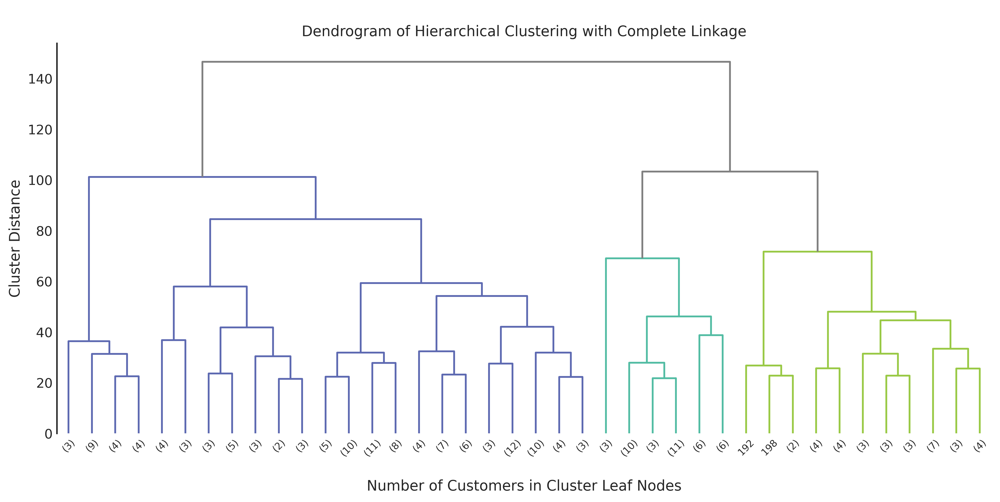

The dendrogram above shows the hierarchical clusters created using complete linkage, which joins pairs of clusters together that have the smallest maximum distance between their observations. The height at which the branches split indicates the distance between the clusters. Clusters that are more similar to each other are joined early on in the tree and become less and less similar as we move up the tree. To identify the number of clusters, we can make a horizontal cut across the dendrogram. For instance, if we were to cut the dendrogram at a height of 100, we would have about three clusters, with the majority of customers in the first cluster, colored purple. Let's look at the results of the hierarchical clustering based on customer's spending and income.

In [336]:
# Hierarchical clustering
hc = AgglomerativeClustering(3, affinity='euclidean', linkage='complete', compute_full_tree=False)
hc_pred = hc.fit_predict(plot_df1)
plot_hc=plot_df1.copy()
plot_hc["Hierarchical Cluster"]=hc_pred
plot_hc=plot_hc.sort_values(by='Hierarchical Cluster')
plot_hc['Hierarchical Cluster'] = plot_hc['Hierarchical Cluster'].astype(str)

# Plot of clusters                                               
fig = px.scatter(plot_hc, x="clean_Ventas", y="clean_Beneficio_por_pedido", color="Hierarchical Cluster",
                 color_discrete_sequence=px.colors.qualitative.Vivid[1:])
fig.update_traces(marker=dict(size=11, opacity=0.75, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(template=temp, title="Hierarchical Cluster Profiles,<br>Customer Spending vs. Income", 
                  width=700, legend_title = 'Cluster',
                  xaxis=dict(title='Spending Score',showline=True, zeroline=False), 
                  yaxis=dict(title='Income, $',ticksuffix='k',showline=True))
fig.show()

Hierarchical clustering tends to put more weight on customer's income in creating the clusters. The largest cluster, Cluster 0, consists of customers who have an annual income of around $70,000 or less and spending scores ranging from 3 to 99, while customers in Clusters 1 and 2 have incomes above $70,000 and are further subdivided into smaller segments based on their spending score.

# DBSCAN

The next clustering technique I will try is Density-Based Spatial Clustering of Applications with Noise (DBSCAN). DBSCAN segments the data based on the density of observations, where areas of high density are separated from areas of low density. The model can also identify uniquely-shaped clusters and detect outliers within the data, although it is sensitive to varying densities of observations.

In [337]:
# DB Scan clustering
db=DBSCAN(eps=15, min_samples=11, metric='euclidean')  #17,15 14,7 12 7 115
db_preds=db.fit_predict(plot_df1)
plot_db=plot_df1.copy()
plot_db['DB Cluster'] = db_preds
plot_db=plot_db.sort_values(by='DB Cluster')
plot_db['DB Cluster'] = plot_db['DB Cluster'].astype(str).apply(lambda x: 'Outliers' if x == '-1' else x)


# Plot of clusters   
fig = px.scatter(plot_db, x="clean_Ventas", y="clean_Beneficio_por_pedido", color="DB Cluster",
                 color_discrete_sequence=px.colors.qualitative.T10[2:])
fig.update_traces(marker=dict(size=11, opacity=0.85, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(template=temp, title="DBSCAN Cluster Profiles,<br>Customer Spending vs. Income", 
                  width=700, legend_title = 'Cluster',
                  xaxis=dict(title='Spending Score',showline=True, zeroline=False), 
                  yaxis=dict(title='Income, $',ticksuffix='k',showline=True))
fig.show()

The DBSCAN model with a local radius of 15 segments the data into four clusters. These segments resemble the clusters from the K-Means model, with the outliers identified in red. Overall, there are quite a few outliers in the graph, which is likely due to the variation in the densities of the clusters.

# Cluster Profile Comparison

Below are the plots of the customer profiles based on age, income, and spending from each clustering model.

In [338]:
# Initializing figure with 3 3D subplots
fig = make_subplots(rows=3, cols=1,
                    vertical_spacing=0.1,
                    specs=[[{'type': 'scatter3d'}],
                           [{'type': 'scatter3d'}], 
                           [{'type': 'scatter3d'}]],
                     subplot_titles=("K-Means Clustering with 5 clusters", 
                                     "Hierarchical Clustering<br>with 3 clusters", 
                                     "DBSCAN<br>with 4 clusters")
                   )

# Adding clusters to scatterplots 
plot_km['K-Means Cluster'] = plot_km['K-Means Cluster'].astype(int)
plot_km=plot_km.sort_values(by='K-Means Cluster')
for i in range(0,5):
    fig.add_trace(go.Scatter3d(x = plot_km[plot_km['K-Means Cluster'] == i]['clean_Ventas'],
                               y = plot_km[plot_km['K-Means Cluster'] == i]['clean_Beneficio_por_pedido'],
                               z = plot_km[plot_km['K-Means Cluster'] == i]['IDCliente'],                        
                               mode = 'markers', marker=dict(
                                   size=7,  
                                   color = px.colors.qualitative.Prism[i],
                                   line_width = 1,
                                   line_color='#F7F7F7',
                                   opacity=0.7),
                               name = str('Cluster '+str(i)), legendgroup = 1),
                 row=1, col=1)

plot_hc['Hierarchical Cluster'] = plot_hc['Hierarchical Cluster'].astype(int)
plot_hc=plot_hc.sort_values(by='Hierarchical Cluster')
for i in range(0,3):    
    fig.add_trace(go.Scatter3d(x = plot_hc[plot_hc['Hierarchical Cluster'] == i]['clean_Ventas'],
                               y = plot_hc[plot_hc['Hierarchical Cluster'] == i]['clean_Beneficio_por_pedido'],
                               z = plot_hc[plot_hc['Hierarchical Cluster'] == i]['IDCliente'],                        
                               mode = 'markers', marker=dict(
                                   size=7,   
                                   color = px.colors.qualitative.Vivid[i+1],
                                   line_width = 1, 
                                   line_color='#F7F7F7',
                                   opacity=0.7),
                               name = str('Hierarchical Cluster '+str(i)), legendgroup = 2), 
                  row=2, col=1)

for i, j in enumerate(plot_db['DB Cluster'].unique()): 
    fig.add_trace(go.Scatter3d(x = plot_db[plot_db['DB Cluster'] == j]['clean_Ventas'],
                               y = plot_db[plot_db['DB Cluster'] == j]['clean_Beneficio_por_pedido'],
                               z = plot_db[plot_db['DB Cluster'] == j]['IDCliente'], 
                               mode = 'markers', marker=dict(
                                   size=7,   
                                   color = px.colors.qualitative.T10[i+2],
                                   line_width = 1,
                                   line_color='#F7F7F7',
                                   opacity=0.8),
                               name = str('DB Cluster '+str(j)), legendgroup = 3), 
                  row=3, col=1)

fig.update_traces(hovertemplate='Customer Spending Score: %{x}<br>Income: $%{z}<br>Age: %{y}')
fig.update_layout(title="Customer Segments based on Income, Spending, and Age",
                  template=temp, height=1800, legend_tracegroupgap = 500,
                  scene=dict(aspectmode='cube',
                             xaxis = dict(title='Spending Score', 
                                          backgroundcolor="#F3F3F3",
                                          gridcolor="white",
                                          showbackground=True,
                                          zerolinecolor="white",),
                             yaxis = dict(title='Age, in years',
                                          backgroundcolor="#E4E4E4",
                                          gridcolor="white",
                                          showbackground=True,
                                          zerolinecolor="white"),
                             zaxis = dict(title='Income, $', 
                                          ticksuffix='k',
                                          backgroundcolor="#F6F6F6",
                                          gridcolor="white",
                                          showbackground=True,
                                          zerolinecolor="white")), 
                  scene2=dict(aspectmode='cube', 
                             xaxis = dict(title='Spending Score',
                                          backgroundcolor="#F3F3F3",
                                          gridcolor="white",
                                          showbackground=True,
                                          zerolinecolor="white",),
                             yaxis = dict(title='Age, in years',
                                          backgroundcolor="#E4E4E4",
                                          gridcolor="white",
                                          showbackground=True,
                                          zerolinecolor="white"),
                             zaxis = dict(title='Income, $', 
                                          ticksuffix='k',
                                          backgroundcolor="#F6F6F6",
                                          gridcolor="white",
                                          showbackground=True,
                                          zerolinecolor="white")), 
                  scene3=dict(aspectmode='cube', 
                             xaxis = dict(title='Spending Score',
                                          backgroundcolor="#F3F3F3",
                                          gridcolor="white",
                                          showbackground=True,
                                          zerolinecolor="white",),
                             yaxis = dict(title='Age, in years',
                                          backgroundcolor="#E4E4E4",
                                          gridcolor="white",
                                          showbackground=True,
                                          zerolinecolor="white"),
                             zaxis = dict(title='Income, $', 
                                          ticksuffix='k',
                                          backgroundcolor="#F6F6F6",
                                          gridcolor="white",
                                          showbackground=True,
                                          zerolinecolor="white"))
                  )
fig.show()


# Conclusion

In this analysis, three clustering models were developed to explore different types of customers at a supermarket: K-Means Clustering, Hierarchical Clustering, and DBSCAN. Each model identified distinct customer segments that the company could target depending on their needs. Out of the three clustering techniques, the K-Means model created the most distinguished clusters, while DBSCAN created a simpler model with only four clusters and identified the outliers within the data. The Hierarchical Clustering model defined the fewest number of clusters overall, with more emphasis placed on customer's income.

Based on customer spending habits, the company could target customers for their membership card program using the two clusters found in the K-Means model, where customers have higher spending scores above 60 and would likely be more inclined to becoming a member. One of the distinguishing factors between these clusters and the other clusters in the model is that they consist of customers who are under the age of 40, which indicates that the company could aim their membership card marketing program towards customers who are younger than 40 and have higher spending scores. To engage customers with lower spending scores, the company could target these groups with more of their popular products and promotions. In the future, to better understand customer preferences, additional data about the frequency and types of purchases made could be used to further customize product offerings to each segment.

References 
Hastie, T., Tibshirani, R., & Friedman, J. H. (2009). The Elements of Statistical Learning: Data Mining, Inference, and Prediction. 2nd ed. New York, NY: Springer.

James, G., Witten, D., Hastie, T., & Tibshirani, R. (2013). An Introduction to Statistical Learning with Applications in R. New York, NY: Springer.



Thank you for reading!
Let me know if you have any questions, and I look forward to any suggestions 🙂